# MTH3302: Méthodes probabilistes et statistiques pour l'I.A.
## Projet

- Vincent Haney
- Félix Pelletier
- Charles-François St-Cyr (275354)
- Mikael Vaillant (2029994)


### 1. Librairies

In [129]:
using CSV, DataFrames, Distributions, Gadfly, MLBase, Random, Statistics, Colors, GLM, LinearAlgebra, Combinatorics, CategoricalArrays,Distances,NearestNeighbors

include("./library/main.jl");
include("./library/normalize.jl");
include("./library/missing-values.jl");

### 2. Visualisation des données

#### 2.1. Chargement des données pour la visualisation

In [130]:
base_data = CSV.read("./data/train_light.csv", DataFrame);

first(base_data, 5)

Row,ID,cut,color,clarity,depth,table,price,x,y,z
,Int64,String15?,String1,String7,Float64?,Float64,Int64,Float64,Float64?,Float64
1,1,missing,E,SI2,60.2,60.0,5340,6.46,6.5,3.9
2,2,Ideal,G,VVS2,62.7,57.0,1936,5.12,5.05,3.19
3,3,Premium,E,VVS1,62.0,59.0,1012,4.33,4.28,2.67
4,4,Ideal,G,VS2,61.7,57.0,720,4.41,4.38,2.71
5,5,missing,G,VS2,62.4,58.0,6301,6.41,6.48,4.02


#### 2.2. Visualisation de la taille

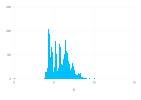

In [131]:
plot(base_data, x = :x, Geom.histogram)

#### 2.3. Comparaison des valeurs de tailles ($X$, $Y$, $Z$)

Nous examinons la relation entre $X$, $Y$ et $Z$. À première vue, ces données sont fortement corrélées, donc notre modèle devrait n'inclure qu'une seule de ces variables.

De plus, nous voyons plusieurs données qui semblent anormales.

In [132]:
plot(stack(base_data, [:y, :z]), x = :x, y = :value, color=:variable, Geom.point)

#### 2.4. Comparaison de $table$ et $depth$

On observe que ces deux variables ne sont pas complètement indépendantes. Les valeurs de $depth$ semblent diminuer légèrement lorsque les valeurs de $table$ augmentent. Cependant, cette corrélation est plutôt faible et il reste de l'information à tirer de ces deux variables.

In [133]:
plot(base_data, x = :table, y = :depth)

#### 2.5. Comparaison de $X$, $Y$ et $Z$ par rapport au coût

On constate que les tailles sont corrélées au prix : plus le prix augmente, plus la taille augmente.

De plus, pour chaque point de donnée, $X$ et $Y$ sont presque égaux. C'est la tendance qui semble se confirmer lorsqu'on analyse les données numériques et le contexte.

On observe aussi quelques données aberrantes, dont des tailles égales à $0$.

In [134]:
plot(stack(base_data, [:x, :y, :z]), x = :price, y = :value, color = :variable)

#### 2.6. Comparaison de $table$ et $depth$ par rapport au coût

À première vue, ces variables ne semblent pas être les meilleures variables explicatives étant donné que la valeur semble être environ la même pour tous les prix, à l'exception de quelques valeurs aberrantes.

In [135]:
plot(stack(base_data, [:table, :depth]), x = :price, y = :value, color = :variable)

### 3. Chargement des données

In [136]:
base_data = CSV.read("./data/train.csv", DataFrame);
base_test = CSV.read("./data/test.csv", DataFrame);

base_train, base_valid = partitionData(base_data, 0.75);

### 4. Détection de la colinéarité

Dans la section 2, nous avons constaté qu'il existe probablement de la colinéarité entre certaines variables explicatives. Par conséquent, nous allons utiliser le VIF. Le VIF pour une variable $A$ est défini comme suit :

$$
VIF_A = \frac{1}{1 - R^2_A}
$$

Où $R^2_A$ est le coefficient de détermination obtenu lorsque $A$ est régressé par rapport aux autres variables explicatives. Une variable est considérée comme étant colinéaire si son coefficient de variabilité interne (VIF) est supérieur à 10.

Comme prévu, les variables $X$, $Y$ et $Z$ sont colinéaires. On constate également que la profondeur et certaines clartés sont aussi colinéaires.

In [137]:
data = deepcopy(base_data)

convertQualitativeToQuantitative(data, :color)
convertQualitativeToQuantitative(data, :cut)
convertQualitativeToQuantitative(data, :clarity)

color_names = getNamesForQuantitative(data, :color)
cut_names = getNamesForQuantitative(data, :cut)
clarity_names = getNamesForQuantitative(data, :clarity)

sort!(
    getAllVIF(data, ["x", "y", "z", "table", "depth", color_names..., cut_names..., clarity_names...]),
    :VIF,
    rev = true,
)

Row,Variable,VIF
,String,Float64
1,z,371.347
2,x,251.472
3,y,31.8934
4,clarity: SI1,13.9398
5,clarity: VS2,13.6598
6,depth,11.2673
7,clarity: SI2,10.9516
8,cut: Ideal,10.6833
9,clarity: VS1,10.2335


### 5. Valeurs manquantes

Examinons les données pour déterminer quelles valeurs sont manquantes.

#### 5.1 Chargement des données

In [138]:
data = deepcopy(base_data);
test = deepcopy(base_test);

#### 5.2 Vérification des données

##### 5.2.1 Data

In [139]:
data_missing_counts = collect(count(ismissing, col) for col in eachcol(data))
data_zero_counts = (hcat([0,0,0,0]',hcat([count(x -> x < 0.05, skipmissing(data[:, col])) for col in [:depth,:table,:price,:x, :y, :z]]...)))'[:, 1]

DataFrame(Variables = names(data), DataMissing = data_missing_counts, DataZero = data_zero_counts)

Row,Variables,DataMissing,DataZero
,String,Int64,Int64
1,ID,0,0
2,cut,3806,0
3,color,0,0
4,clarity,0,0
5,depth,2201,13
6,table,0,0
7,price,0,0
8,x,0,4
9,y,2200,3


#### 5.2.2 Test

In [140]:

test_missing_counts = collect(count(ismissing, col) for col in eachcol(test))
test_zero_counts = (hcat([0,0,0,0]',hcat([count(x -> x < 0.05, skipmissing(test[:, col])) for col in [:depth,:table,:x, :y, :z]]...)))'[:, 1]

DataFrame(Variables = names(test), DataMissing = test_missing_counts, DataZero = test_zero_counts)

Row,Variables,DataMissing,DataZero
,String,Int64,Int64
1,ID,0,0
2,cut,1194,0
3,color,0,0
4,clarity,0,0
5,depth,800,5
6,table,0,0
7,x,0,4
8,y,800,4
9,z,0,5


### 6. **Méthode 1** : Régression linéaire simple

La première étape consiste à effectuer une régression linéaire simple. Les données manquantes seront remplacées naïvement. Cette méthode n'est pas optimale car elle ne donne pas une bonne estimation des valeurs manquantes. Néanmoins, elle nous fournit un $RMSE$ que nous pouvons utiliser comme référence pour la suite.

#### 6.1 Chargement des données

In [141]:
data = deepcopy(base_data);
test = deepcopy(base_test);
train = deepcopy(base_train);
valid = deepcopy(base_valid);

#### 6.2 Traitement des valeurs manquantes

On remarque que les colonnes $cut$, $depth$ et $y$ comportent des valeurs manquantes. 

Comme les valeurs de $x$ sont très proches de celles de $y$, nous remplacerons les valeurs manquantes de $y$ par celles de $x$.

Pour $cut$, nous remplacerons les valeurs manquantes par le mode.

Pour $depth$, nous connaissons la formule pour le calculer: $2\times\frac{z}{x+y}$. Puisque nous remplacerons les valeurs manquantes de $y$, nous pourrons recalculer la valeur.

In [142]:
replaceValuesNaive.([train, valid, test])

first(train, 5)

Row,ID,cut,color,clarity,depth,table,price,x,y,z
,Int64,String15?,String1,String7,Float64,Float64,Int64,Float64,Float64,Float64
1,2,Ideal,G,VVS2,62.7,57.0,1936,5.12,5.05,3.19
2,3,Premium,E,VVS1,62.0,59.0,1012,4.33,4.28,2.67
3,4,Ideal,G,VS2,61.7,57.0,720,4.41,4.38,2.71
4,7,Very Good,D,SI1,60.2,61.0,571,4.39,4.42,2.65
5,8,Very Good,I,SI1,62.5,58.0,4450,6.5,6.58,4.09


#### 6.3 Gestion de la colinéarité : Introduction d'une nouvelle variable

Nous savons que les variables $X$, $Y$ et $Z$ sont très corrélées. Pour éviter ce problème, nous introduisons une variable de volume. Comme le poids est un élément important pour déterminer le prix d'un diamant, nous estimons que le volume est une bonne variable explicative. Nous définissons donc :

$$
volume = x \times y \times z
$$

In [143]:
train[!, :volume] = train.x .* train.y .* train.z
valid[!, :volume] = valid.x .* valid.y .* valid.z
test[!, :volume] = test.x .* test.y .* test.z;

In [144]:
plot(first(train, 5000), x = :volume, y = :price)

#### 6.4 Définition du modèle

In [145]:
M = lm(@formula(price ~ volume + cut + clarity + color), train)

StatsModels.TableRegressionModel{LinearModel{GLM.LmResp{Vector{Float64}}, GLM.DensePredChol{Float64, CholeskyPivoted{Float64, Matrix{Float64}, Vector{Int64}}}}, Matrix{Float64}}

price ~ 1 + volume + cut + clarity + color

Coefficients:
────────────────────────────────────────────────────────────────────────────────
                     Coef.  Std. Error       t  Pr(>|t|)   Lower 95%   Upper 95%
────────────────────────────────────────────────────────────────────────────────
(Intercept)     -6996.83     71.3839    -98.02    <1e-99  -7136.75    -6856.92
volume             54.8598    0.100857  543.94    <1e-99     54.6622     55.0575
cut: Good         563.682    48.1334     11.71    <1e-30    469.338     658.026
cut: Ideal        728.787    43.3547     16.81    <1e-62    643.81      813.764
cut: Premium      672.798    44.1635     15.23    <1e-51    586.235     759.36
cut: Very Good    639.745    44.6361     14.33    <1e-45    552.256     727.233
clarity: IF      5237.43     70.8163     

#### 6.5 Validation du modèle

Ce modèle donne généralement une erreur quadratique moyenne (RMSE) comprise entre $1200$ et $1250$. Nous pouvons donc utiliser cette valeur pour comparer par la suite si un modèle est performant.

In [146]:
θ̂ = predict(M, valid)
rmse = RMSE(θ̂, valid.price)

println("RMSE: $(round(rmse))")

RMSE: 2283.0


### 7. **Méthode 2** : Régression linéaire avec estimation des valeurs manquantes par régression

Au départ, nous avons opté pour des méthodes plus simples pour estimer les valeurs manquantes. Pour améliorer notre estimation, nous allons donc améliorer notre approche. Toutefois, nous conserverons la même stratégie pour estimer la profondeur.

#### 7.1 Chargement des données

In [147]:
data = deepcopy(base_data);
test = deepcopy(base_test);
train = deepcopy(base_train);
valid = deepcopy(base_valid);

#### 7.2 Transformation de la variable cut

Puisque la variable "cut" est qualitative, il n'est pas possible d'utiliser un modèle linéaire pour l'estimer directement. Nous allons donc transformer la variable pour la rendre quantitative, comme indiqué dans ce tableau.

| Valeur        | cut: Good | cut: Ideal | cut: Premium | cut: Very Good |
| ------------- | --------- | ---------- | ------------ | -------------- |
| $Fair$        | $0$       | $0$        | $0$          | $0$            |
| $Good$        | $1$       | $0$        | $0$          | $0$            |
| $Ideal$       | $0$       | $1$        | $0$          | $0$            |
| $Premium$     | $0$       | $0$        | $1$          | $0$            |
| $Very$ $Good$ | $0$       | $0$        | $0$          | $1$            |

In [148]:
convertQualitativeToQuantitative.([train, valid, test], :cut)

cut_names = getNamesForQuantitative(train, :cut)

first(train, 5)

Row,ID,cut,color,clarity,depth,table,price,x,y,z,cut: Good,cut: Ideal,cut: Premium,cut: Very Good
,Int64,String15?,String1,String7,Float64?,Float64,Int64,Float64,Float64?,Float64,Int64?,Int64?,Int64?,Int64?
1,2,Ideal,G,VVS2,62.7,57.0,1936,5.12,5.05,3.19,0,1,0,0
2,3,Premium,E,VVS1,62.0,59.0,1012,4.33,4.28,2.67,0,0,1,0
3,4,Ideal,G,VS2,61.7,57.0,720,4.41,4.38,2.71,0,1,0,0
4,7,Very Good,D,SI1,60.2,61.0,571,4.39,4.42,2.65,0,0,0,1
5,8,Very Good,I,SI1,62.5,58.0,4450,6.5,6.58,4.09,0,0,0,1


#### 7.3 Traitement des valeurs manquantes

Pour la variable $y$, nous définissons un modèle $y ~ x + table$. Nous remplaçons ensuite les valeurs manquantes par la prédiction de ce modèle.

La variable $depth$ est traitée de la même manière qu'à la section 6.2, c'est-à-dire que sa valeur est recalculée en utilisant $x$, $y$ et $z$.

Pour la variable $cut$, nous définissons $n - 1$ modèles pour chaque valeur. Lorsque $cut$ est manquant, nous remplaçons les valeurs quantitatives par l'estimation.

In [149]:
replaceValuesRegression.([train, valid, test])

first(train, 5)

Row,ID,cut,color,clarity,depth,table,price,x,y,z,cut: Good,cut: Ideal,cut: Premium,cut: Very Good
,Int64,String15?,String1,String7,Float64,Float64,Int64,Float64,Float64,Float64,Real,Real,Real,Real
1,2,Ideal,G,VVS2,62.7,57.0,1936,5.12,5.05,3.19,0,1,0,0
2,3,Premium,E,VVS1,62.0,59.0,1012,4.33,4.28,2.67,0,0,1,0
3,4,Ideal,G,VS2,61.7,57.0,720,4.41,4.38,2.71,0,1,0,0
4,7,Very Good,D,SI1,60.2,61.0,571,4.39,4.42,2.65,0,0,0,1
5,8,Very Good,I,SI1,62.5,58.0,4450,6.5,6.58,4.09,0,0,0,1


#### 7.4 Gestion de la colinéarité : Introduction d'une nouvelle variable

Tout comme dans l'étape précédente, nous allons introduire la variable :

$$
volume = x \times y \times z
$$

In [150]:
train[!, :volume] = train.x .* train.y .* train.z
valid[!, :volume] = valid.x .* valid.y .* valid.z
test[!, :volume] = test.x .* test.y .* test.z;

#### 7.5 Définition du modèle

In [151]:
M = lm(term(:price) ~ term(:volume) + term(:clarity) + term(:color) + sum(term.(cut_names)), train)

StatsModels.TableRegressionModel{LinearModel{GLM.LmResp{Vector{Float64}}, GLM.DensePredChol{Float64, CholeskyPivoted{Float64, Matrix{Float64}, Vector{Int64}}}}, Matrix{Float64}}

price ~ 1 + volume + clarity + color + cut: Good + cut: Ideal + cut: Premium + cut: Very Good

Coefficients:
────────────────────────────────────────────────────────────────────────────────
                     Coef.  Std. Error       t  Pr(>|t|)   Lower 95%   Upper 95%
────────────────────────────────────────────────────────────────────────────────
(Intercept)     -6986.41     71.1421    -98.20    <1e-99  -7125.85    -6846.96
volume             54.8781    0.101049  543.09    <1e-99     54.6801     55.0762
clarity: IF      5225.2      70.9868     73.61    <1e-99   5086.07     5364.34
clarity: SI1     3379.37     60.7099     55.66    <1e-99   3260.38     3498.36
clarity: SI2     2440.29     60.9789     40.02    <1e-99   2320.77     2559.82
clarity: VS1     4315.51     61.9544     69.66    <1e-99   4194.07     4

#### 7.6 Validation du modèle

Ce modèle nous donne le même RMSE. La régression pour compléter les données manquantes ne semble pas faire une grande différence.

In [152]:
θ̂ = predict(M, valid)
rmse = RMSE(θ̂, valid.price)

println("RMSE: $(round(rmse))")

RMSE: 2284.0


### 8. **Méthode 3** : Analyse en composantes principales

La méthode 2 n'a pas amélioré les résultats par rapport à la méthode 1. Nous devons donc utiliser une autre méthode. Avec la méthode 1, nous avons introduit la variable $volume$ pour tenter de contourner le problème de colinéarité. Cependant, cette technique n'est pas optimale car elle supprime des informations sur les valeurs individuelles de $x$, $y$ et $z$, et ne prend pas en compte la colinéarité entre les variables $depth$ et $clarity$.

L'analyse en composantes principales est un excellent moyen pour résoudre ce problème. Notons qu'elle est généralement avantageuse pour des jeux de données avec un grand nombre de variables explicatives. Dans notre jeu de données, l'information n'est peut-être pas suffisamment concentrée dans certaines variables explicatives pour que nous soyons capable d'en éliminer quelques-unes sans perdre trop d'information.

#### 8.1. Chargement des données

In [153]:
data = deepcopy(base_data);
test = deepcopy(base_test);
train = deepcopy(base_train);
valid = deepcopy(base_valid);

#### 8.2. Transformation des valeurs qualitatives

In [154]:
convertQualitativeToQuantitative.([train, valid, test], :cut)
convertQualitativeToQuantitative.([train, valid, test], :color)
convertQualitativeToQuantitative.([train, valid, test], :clarity)

cut_names = getNamesForQuantitative(train, :cut)
color_names = getNamesForQuantitative(train, :color)
clarity_names = getNamesForQuantitative(train, :clarity)

first(train, 5)

Row,ID,cut,color,clarity,depth,table,price,x,y,z,cut: Good,cut: Ideal,cut: Premium,cut: Very Good,color: E,color: F,color: G,color: H,color: I,color: J,clarity: IF,clarity: SI1,clarity: SI2,clarity: VS1,clarity: VS2,clarity: VVS1,clarity: VVS2
,Int64,String15?,String1,String7,Float64?,Float64,Int64,Float64,Float64?,Float64,Int64?,Int64?,Int64?,Int64?,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64
1,2,Ideal,G,VVS2,62.7,57.0,1936,5.12,5.05,3.19,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1
2,3,Premium,E,VVS1,62.0,59.0,1012,4.33,4.28,2.67,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0
3,4,Ideal,G,VS2,61.7,57.0,720,4.41,4.38,2.71,0,1,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0
4,7,Very Good,D,SI1,60.2,61.0,571,4.39,4.42,2.65,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0
5,8,Very Good,I,SI1,62.5,58.0,4450,6.5,6.58,4.09,0,0,0,1,0,0,0,0,1,0,0,1,0,0,0,0,0


#### 8.3. Traitement des valeurs manquantes

Les valeurs manquantes sont traitées de la même manière que dans la section 7.3, soit en effectuant une régression sur les variables qui manquent.

In [155]:
replaceValuesRegression.([train, valid, test])

first(train, 5)

Row,ID,cut,color,clarity,depth,table,price,x,y,z,cut: Good,cut: Ideal,cut: Premium,cut: Very Good,color: E,color: F,color: G,color: H,color: I,color: J,clarity: IF,clarity: SI1,clarity: SI2,clarity: VS1,clarity: VS2,clarity: VVS1,clarity: VVS2
,Int64,String15?,String1,String7,Float64,Float64,Int64,Float64,Float64,Float64,Real,Real,Real,Real,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64
1,2,Ideal,G,VVS2,62.7,57.0,1936,5.12,5.05,3.19,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1
2,3,Premium,E,VVS1,62.0,59.0,1012,4.33,4.28,2.67,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0
3,4,Ideal,G,VS2,61.7,57.0,720,4.41,4.38,2.71,0,1,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0
4,7,Very Good,D,SI1,60.2,61.0,571,4.39,4.42,2.65,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0
5,8,Very Good,I,SI1,62.5,58.0,4450,6.5,6.58,4.09,0,0,0,1,0,0,0,0,1,0,0,1,0,0,0,0,0


#### 8.3. Définition des matrices

$X$: Matrice de données d'entrainement

$Z$: Matrice normalisée de données d'entrainement

$y$: Vecteur des prédictions pour l'entrainement

In [156]:
cols = ["table", "depth", "x", "y", "z", cut_names..., color_names..., clarity_names...]

X = select(train, cols)
y = train.price
Z = hcat(ones(nrow(train)), Matrix(standardize(X)))

30341×23 Matrix{Float64}:
 1.0  -0.20351    0.536001   -0.541755  …  -0.544369  -0.270236   3.11844
 1.0   0.693266   0.149612   -1.24554      -0.544369   3.70034   -0.320663
 1.0  -0.20351   -0.0159832  -1.17427       1.83693   -0.270236  -0.320663
 1.0   1.59004   -0.84396    -1.19209      -0.544369  -0.270236  -0.320663
 1.0   0.244878   0.425604    0.687641     -0.544369  -0.270236  -0.320663
 1.0   0.693266   1.47437    -0.381399  …  -0.544369  -0.270236  -0.320663
 1.0  -0.20351    0.315207    0.767819     -0.544369  -0.270236  -0.320663
 1.0   0.693266  -0.899158    0.135304     -0.544369  -0.270236  -0.320663
 1.0   0.693266  -1.50634     0.144212      1.83693   -0.270236  -0.320663
 1.0   0.693266  -0.181578    2.23775       1.83693   -0.270236  -0.320663
 ⋮                                      ⋱   ⋮                    
 1.0   2.03843   -1.94793     1.82795      -0.544369  -0.270236  -0.320663
 1.0  -0.651899   0.480803    0.669823     -0.544369  -0.270236  -0.320663
 1.0  -0.

#### 8.4. Décomposition de la matrice $Z$

In [157]:
U, S, V = svd(Z);

#### 8.5. Variance expliquée par les composantes principales

L'objectif est de déterminer le nombre de variables requises pour notre estimation.

Nous constatons qu'utiliser 18 des 23 variables explicatives permet d'obtenir près de 100%. Par souci de simplicité, nous conservons les 23 variables.

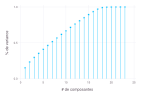

In [158]:
v = cumsum(S.^2) / sum(S.^2)

plot(x=1:length(v), y=v, Geom.point, Geom.hair,
    Guide.xlabel("# de composantes"), 
    Guide.ylabel("% de variance"))

#### 8.6. Calcul de la matrice des composantes principales

In [159]:
T = Z * V;

#### 8.7. Vérification de la colinéarité

Puisque l'objectif de cette technique est de ne pas avoir de multicolinéarité, alors on peut calculer les VIF pour s'en assurer. Ici, on voit que les VIF sont tous à $1$, on peut donc confirmer qu'il n'y a aucune colinéarité puisque les composantes sont orthogonales.

In [160]:
getAllVIF(DataFrame(T, :auto))

Row,Variable,VIF
,String,Float64
1,x1,1.0
2,x2,1.0
3,x3,1.0
4,x4,1.0
5,x5,1.0
6,x6,1.0
7,x7,1.0
8,x8,1.0
9,x9,1.0


#### 8.8. Régression sur l'analyse en composantes principales

Nous allons utiliser notre vecteur $y$ pour estimer les facteurs de régression.

In [161]:
η̂ = T \ y

β̂ = V * η̂;

#### 8.9. Validation du modèle

À l'aide de cette méthode, le RMSE est plus grande qu'aux étapes précédentes. Par conséquent, ce n'est pas concluant.

In [162]:
Ỹ = hcat(ones(nrow(valid)), standardize(Matrix(select(valid, cols))))

ŷ = Ỹ * β̂
rmse = RMSE(ŷ, valid.price)

println("RMSE: $(round(rmse))")

RMSE: 1819.0


### 9. **Méthode 4** : KNN simple

Nous n'avons pas obtenu de meilleurs résultats avec les deux méthodes précédentes que ceux obtenus avec la régression linéaire simple. Par conséquent, nous avons décidé d'explorer une nouvelle voie : KNN. 

Notre théorie est que les diamants vendus sont standards et se répètent. En outre, en visualisant la taille, nous remarquons des pics, ce qui indique qu'il y a des catégories de taille.

Par conséquent, nous croyons que pour les diamants du fichier de test, nous pourrons trouver des diamants similaires et estimer leur prix à l'aide de la moyenne.

#### 9.1. Chargement des données

In [163]:
data = deepcopy(base_data);
test = deepcopy(base_test);
train = deepcopy(base_train);
valid = deepcopy(base_valid);

#### 9.2. Transformation des valeurs qualitatives

Ici, les valeurs de $cut$ ne sont pas considérées puisqu'elles nuisent au modèle.

In [164]:
convertQualitativeToQuantitative.([train, valid, test], :color)
convertQualitativeToQuantitative.([train, valid, test], :clarity)

color_names = getNamesForQuantitative(train, :color)
clarity_names = getNamesForQuantitative(train, :clarity)

first(train, 5)

Row,ID,cut,color,clarity,depth,table,price,x,y,z,color: E,color: F,color: G,color: H,color: I,color: J,clarity: IF,clarity: SI1,clarity: SI2,clarity: VS1,clarity: VS2,clarity: VVS1,clarity: VVS2
,Int64,String15?,String1,String7,Float64?,Float64,Int64,Float64,Float64?,Float64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64
1,2,Ideal,G,VVS2,62.7,57.0,1936,5.12,5.05,3.19,0,0,1,0,0,0,0,0,0,0,0,0,1
2,3,Premium,E,VVS1,62.0,59.0,1012,4.33,4.28,2.67,1,0,0,0,0,0,0,0,0,0,0,1,0
3,4,Ideal,G,VS2,61.7,57.0,720,4.41,4.38,2.71,0,0,1,0,0,0,0,0,0,0,1,0,0
4,7,Very Good,D,SI1,60.2,61.0,571,4.39,4.42,2.65,0,0,0,0,0,0,0,1,0,0,0,0,0
5,8,Very Good,I,SI1,62.5,58.0,4450,6.5,6.58,4.09,0,0,0,0,1,0,0,1,0,0,0,0,0


#### 9.3. Traitement des valeurs manquantes

In [165]:
replaceValuesRegression.([train, valid, test], ignoreCut = true)

first(train, 5)

Row,ID,cut,color,clarity,depth,table,price,x,y,z,color: E,color: F,color: G,color: H,color: I,color: J,clarity: IF,clarity: SI1,clarity: SI2,clarity: VS1,clarity: VS2,clarity: VVS1,clarity: VVS2
,Int64,String15?,String1,String7,Float64,Float64,Int64,Float64,Float64,Float64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64
1,2,Ideal,G,VVS2,62.7,57.0,1936,5.12,5.05,3.19,0,0,1,0,0,0,0,0,0,0,0,0,1
2,3,Premium,E,VVS1,62.0,59.0,1012,4.33,4.28,2.67,1,0,0,0,0,0,0,0,0,0,0,1,0
3,4,Ideal,G,VS2,61.7,57.0,720,4.41,4.38,2.71,0,0,1,0,0,0,0,0,0,0,1,0,0
4,7,Very Good,D,SI1,60.2,61.0,571,4.39,4.42,2.65,0,0,0,0,0,0,0,1,0,0,0,0,0
5,8,Very Good,I,SI1,62.5,58.0,4450,6.5,6.58,4.09,0,0,0,0,1,0,0,1,0,0,0,0,0


#### 9.4. Manipulation des données

Pour chaque ensemble, on ne garde que les variables quantitative qui nous intéresse. On ignore $cut$, $table$ et $depth$ puisqu'ils nuisent au modèle.

In [166]:
Mat_train = Matrix(
    standardize(
        select(
            train,
            Not(["price","cut","ID","color","clarity","depth","table"]),
        )
    )
)';

Mat_valid = Matrix(
    standardize(
        select(
            valid,
            Not(["price","cut","ID","color","clarity","depth","table"]),
        )
    )
)';

Mat_test = Matrix(
    standardize(
        select(
            test,
            Not(["cut","ID","color","clarity","depth","table"]),
        )
    )
)';

#### 9.5. Définition de l'arbre KNN

In [167]:
# Génération de l'arbre de données et ajout de poids pour les différentes variables
weight = zeros(size(Mat_train,1))

weight[1:3]   .= 1; # x, y, z
weight[4:9]   .= 1; # color
weight[10:16] .= 1; # clarity

kdtree = KDTree(Mat_train, WeightedEuclidean(weight));

#### 9.6. Validation du modèle

Ce modèle nous offre un RMSE nettement amélioré. Nous allons donc l'utiliser pour effectuer nos prédictions.

In [168]:
# Nombre de plus proches voisins à utiliser
k = 5

# Algo knn pour valid
idxs, dists = knn(kdtree, Mat_valid, k, true)

prediction = [
    dot(train.price[idxs[i]], dists[i]) / sum(dists[i])
    for i in 1:size(idxs, 1)
]

rmse = RMSE(prediction, valid.price)

println("RMSE: $(round(rmse))")

RMSE: 738.0


#### 9.7. Prédictions

In [169]:
# Nombre de plus proches voisins à utiliser
k = 5

# Algo knn pour valid
idxs, dists = knn(kdtree, Mat_test, k, true)

predictions = [
    dot(train.price[idxs[i]], dists[i]) / sum(dists[i])
    for i in 1:size(idxs, 1)
]

CSV.write("./results/predictions.csv", DataFrame(ID = test.ID, price = predictions));

### 10. Analyse

#### 10.1. Pistes ignorées

1. Nous avions pensé à regrouper certaines classes ensemble. Par exemple, pour la clarté, nous avions pensé, puisque certaines catégories sont colinéaires, que nous pourrions les regrouper. Cependant, lorsque nous avons décidé d'explorer l'analyse en composantes principales et KNN, nous nous sommes dit que ce n'était pas nécessaire.

2. Lorsqu'on a fait un histogramme avec la taille, nous avons remarqué qu'il semblait y avoir plusieurs pics de données. Nous avons estimé que c'est possible qu'il y ait des catégories de taille plutôt que des tailles spécifiques de diamant. Cependant, ça ne semblait pas nécessaire avec notre avenue finale (KNN), donc nous n'avons pas continué avec cette idée.

3. Pour KNN, nous voulions utiliser 2 modèles KNN différents pour les entrées avec un $y$ et les entrées sans. Cependant, cette technique était beaucoup plus lourde sur le code et nous obtenions les mêmes résultats qu'avec les estimations par régression fait précédemment. Nous pensions que nous pourrions diminuer l'incertitude de nos prédictions, cependant, puisque $y$ est très corrélé, l'estimation par régression n'a pas une grande incertitude. C'est pourquoi nous pensons que le résultat est le même.

#### 10.2. À améliorer

1. Pour KNN, nous avons ignoré les variables $cut$, $table$ et $depth$. Cependant, pour la régression, la variables $cut$ était significative et contribuait au modèle. Il serait intéressant de comprendre pourquoi en KNN ce n'est pas le cas et si ça serait possible d'améliorer notre modèle en l'utilisant d'une autre manière.